In [1]:
from astropy import table
import numpy as  np
from astropy.table import Table
import matplotlib.pyplot as plt
from astropy.io import ascii
import pylab as py
import zipfile
from astropy.stats import LombScargle
import os
import os.path
import statistics
import scipy
from scipy.optimize import curve_fit
import scipy.optimize as optimization
import wget

%matplotlib inline

In [2]:
'''
url = 'http://www.astrouw.edu.pl/asas/data/00.tgz'
asas_ra_0_1 = wget.download(url)
# in folder 00
'''

In [5]:
'''
bins = ['01', '02', '03', '04', '05', '06']
for number in bins:
    ra = number
    url = ('http://www.astrouw.edu.pl/asas/data/%s.tgz' %(ra))
    download = wget.download(url)
'''

In [20]:
'''
url = 'http://www.astrouw.edu.pl/asas/data/07.tgz'
download = wget.download(url)
'''

In [34]:
'''
asas_data = []

imported_asas_lightcurves = os.listdir('asas')
for curve in imported_asas_lightcurves:
    with open(os.path.join('asas', curve), "r") as src_file:
        data = src_file.read()
        asas_data.append(data) 
'''

In [73]:
len(candidates)

667

In [74]:
len(periods)

429

In [75]:
len(non_varying)

80

In [9]:
curves = []
periods = []
non_varying = []

for file in os.listdir('04'):
    with open(os.path.join('04', file), "r") as src_file:
        curve = src_file.read()
        curves.append(curve)
        
for file in os.listdir('05'):
    with open(os.path.join('05', file), "r") as src_file:
        curve = src_file.read()
        curves.append(curve)       
for curve in curves: 
    try:
        lc = Table.read(curve, data_start=2,format='ascii')
        time = lc['col1']
        rMag = lc['col2']
        error = lc['col7']
        m = (rMag < 20) & (error<2)

        oMag = rMag[m]
        otime = time[m]
        lb= 0.2
        ub= 12
        nfreq=200000
        ofreq=np.linspace(lb, ub, nfreq)
        opower= LombScargle(otime, oMag).power(ofreq)
        power= opower[((ofreq%1)<0.95) & ((ofreq%1)>0.05)]
        freq= ofreq[((ofreq%1)<0.95) & ((ofreq%1)>0.05)]
        if np.max(power)>0.35 and len(time[m])>50:
            periods.append(curve)
        
        avmag = np.mean(rMag[m])
        chi2 = np.sum((rMag[m] - avmag)**2/(error[m]**2))
        reduced_chi2 = (chi2)/(len(rMag[m])-1)
        if reduced_chi2 < 3 and len(time[m])>50:
            non_varying.append(curve)
    except:
        print(curve)
        pass

In [4]:
len(curves)

2888

In [12]:
candidates = []
candidates = list(curves)
non_quasars = []
baddata = []

for curve in non_varying:
    non_quasars.append(curve)
for curve in periods:
    non_quasars.append(curve)

for curve in candidates:
    try:
        lc = Table.read(curve, data_start=2,format='ascii')
        time = lc['col1']
        rMag = lc['col7']
        error = lc['col8']
        m = (rMag > -20) & (error<2)
        if len(time[m]) < 50:
            baddata.append(curve)    
    except:
        print(curve)
        pass   

In [13]:
for i in candidates[:]:
    if i in non_quasars:
        candidates.remove(i)

NameError: name 'candidates_ra0405' is not defined

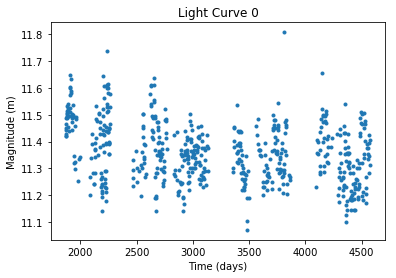

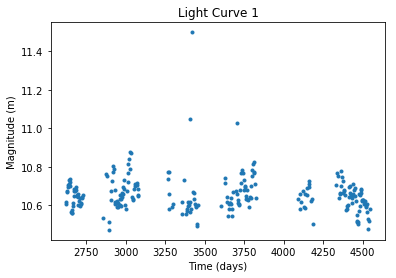

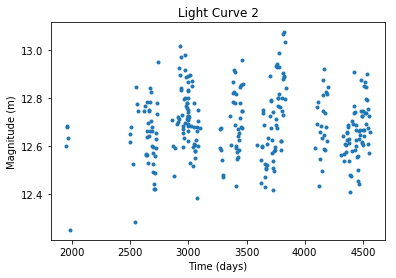

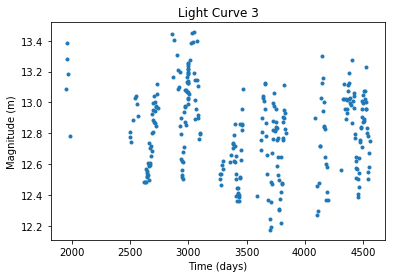

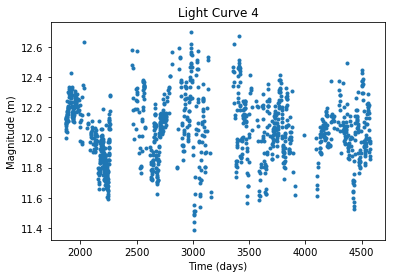

...

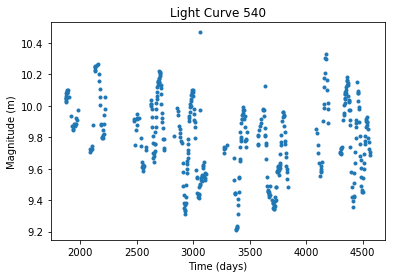

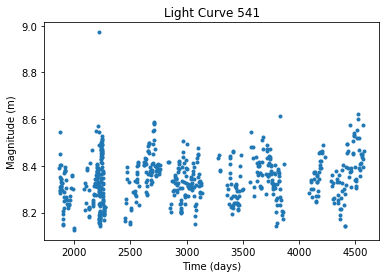

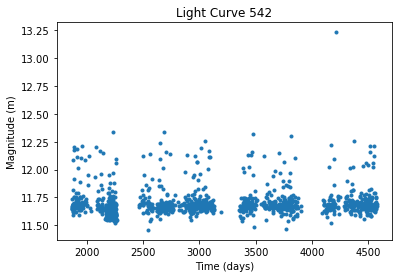

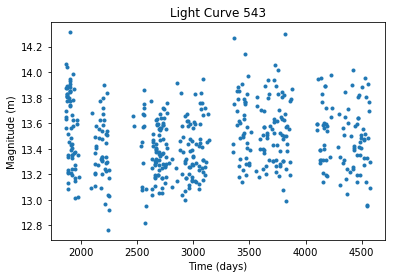

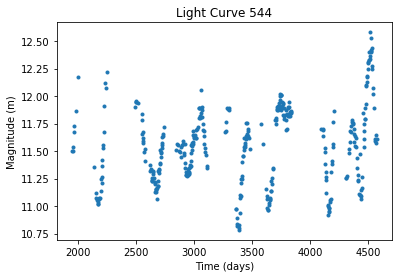

545


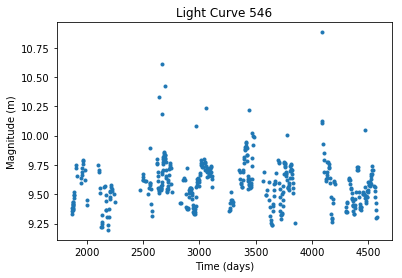

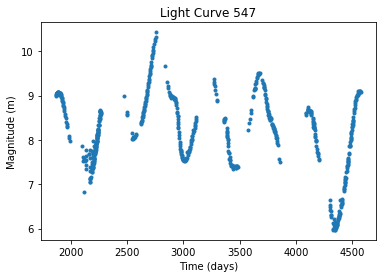

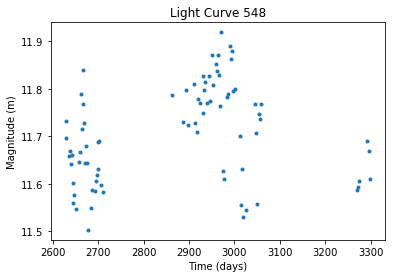

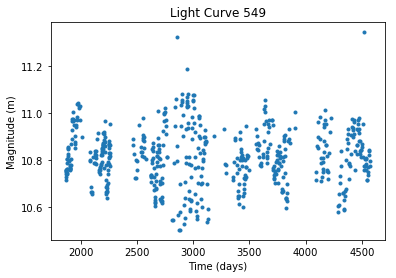

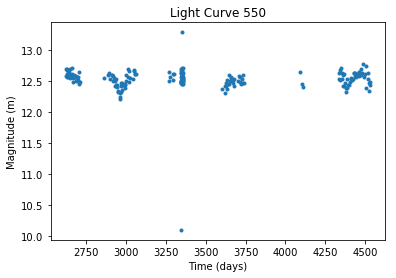

...

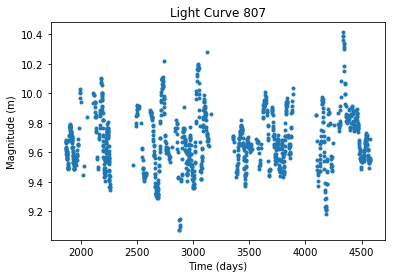

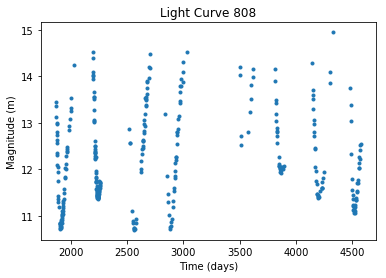

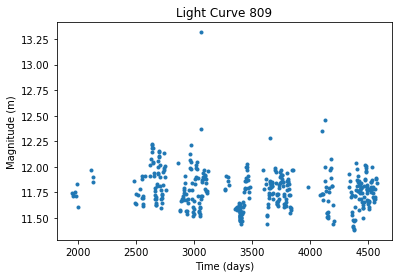

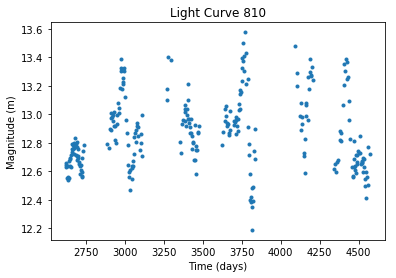

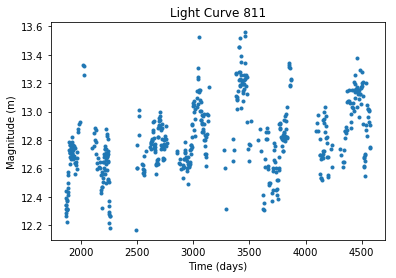

812


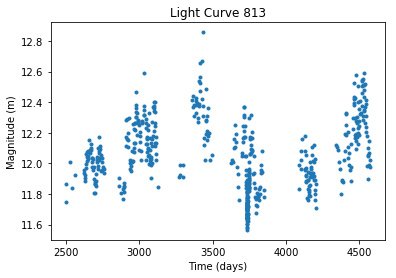

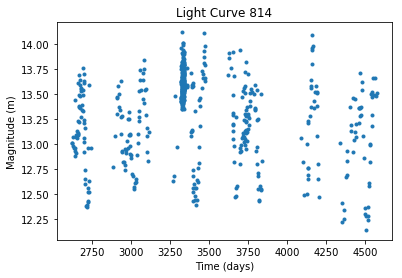

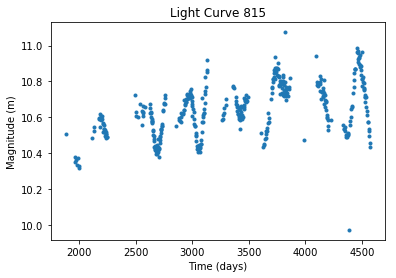

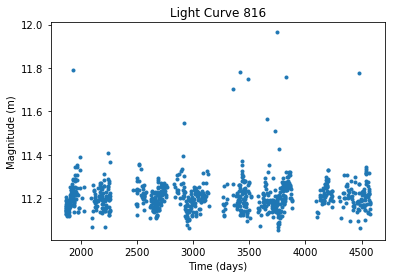

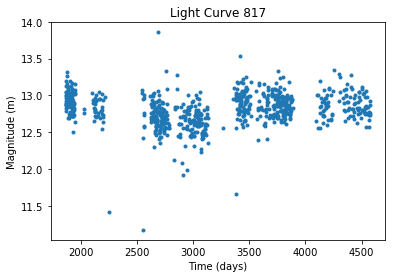

...

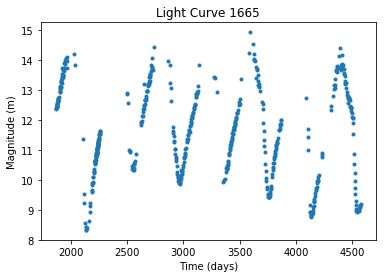

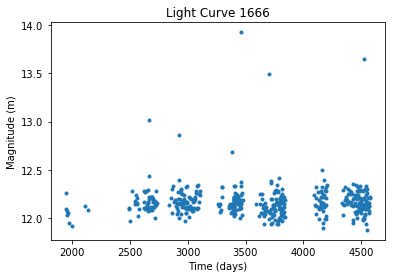

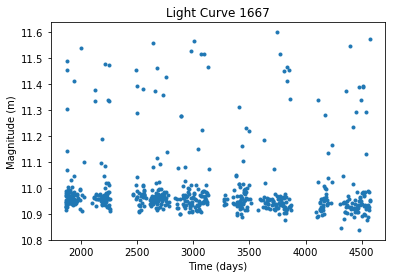

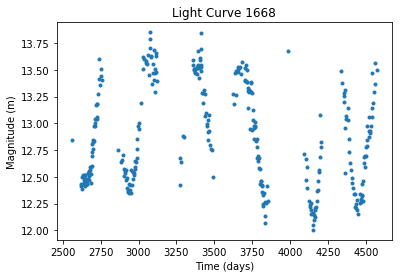

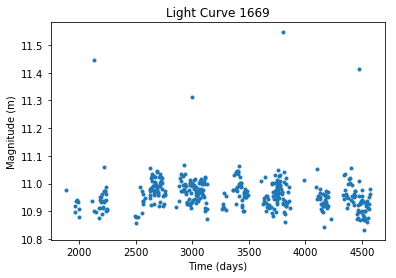

1670


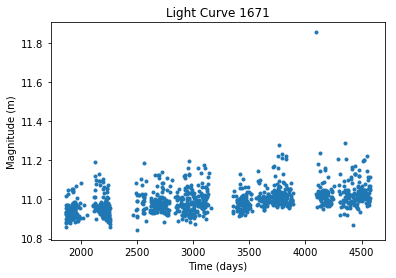

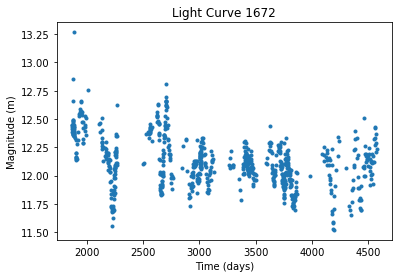

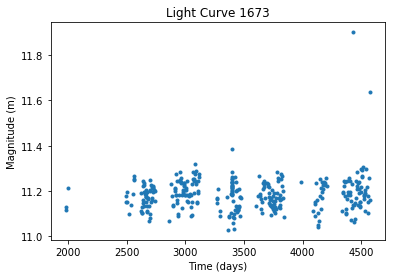

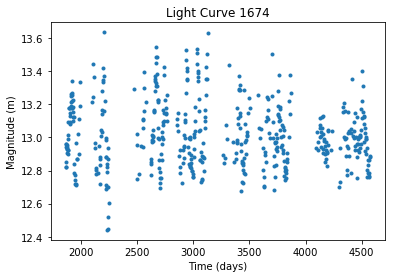

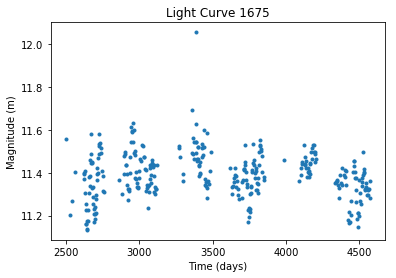

...

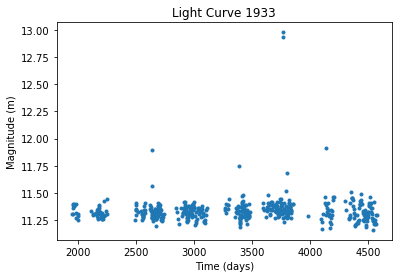

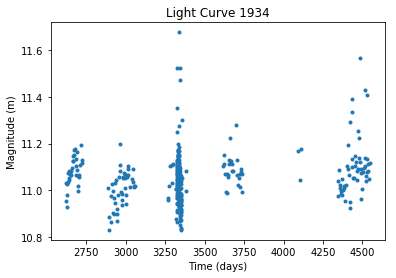

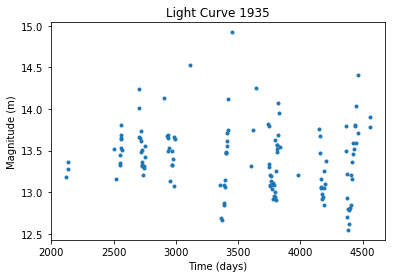

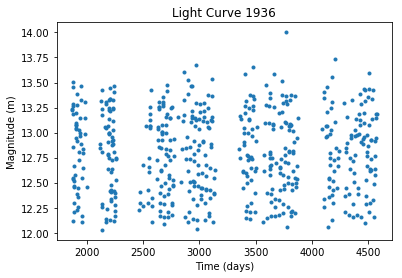

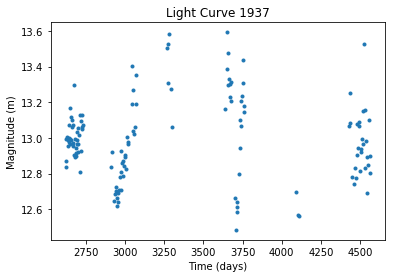

In [96]:
# 5370 curves
# 662 candidates from 00 and 01
# 744 candidates from 02 and 03
# 1938 candidates from 04 and 05
#  
# plot curves
for i in range (0,1938):
    try:
        lc = Table.read(candidates[i], data_start=2,format='ascii')
        time = lc['col1']
        rMag = lc['col2']
        error = lc['col7']
        m = (rMag < 20) & (error<2)
        plt.plot(time[m], rMag[m], '.')
        plt.title("Light Curve %s" %(i))
        plt.xlabel("Time (days)")
        plt.ylabel("Magnitude (m)") 
        plt.show()
    except:
        print(i)
        pass   

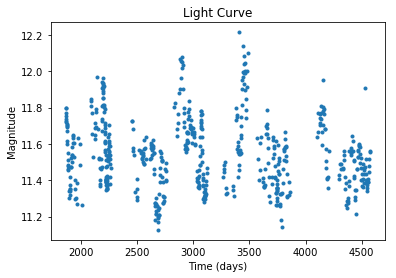

In [35]:
# RA 00, 01
# bad cand. [0][95][204][222]
# good cand. [28]* [341]*

# RA 02, 03
# bad cand.
# good cand. [103]*[122]* 
# 
# RA 04, 05
# good cand. [11]* [78]* [91]* [431]* [593]* [695]* [1053]* [1250]* [1517]* [1701]* 
# [1929]*

#VIABLE: 17

lc = Table.read(candidates[34], data_start=2,format='ascii')
time = lc['col1']
rMag = lc['col2']
error = lc['col7']
m = (rMag < 20) & (error<2)
plt.plot(time[m], rMag[m], '.')
plt.title("Light Curve")
#plt.ylim(12, 13.5)
plt.xlabel("Time (days)")
plt.ylabel("Magnitude")

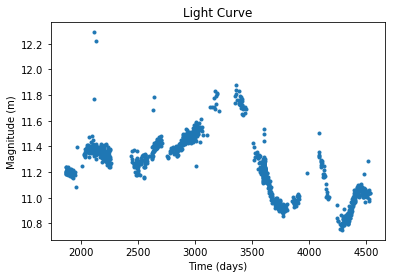

In [65]:
lc = Table.read( ra_0001 [0], data_start=2,format='ascii')
time = lc['col1']
rMag = lc['col2']
error = lc['col7']
m = (rMag < 20) & (error<2)
plt.plot(time[m], rMag[m], '.')
plt.title("Light Curve")
plt.xlabel("Time (days)")
plt.ylabel("Magnitude (m)")

In [ ]:
for i in range(0,#):
    lc = Table.read(candidates[i], data_start=2,format='ascii')
    time = lc['col1']
    rMag = lc['col2']
    error = lc['col7']
    m = (rMag < 20) & (error<2)

    if any rMag[m] > 6:
        pass
    else:
        plt.plot(time[m], rMag[m],'.')
        plt.title("Light Curve %s" %(1))
        plt.xlabel("Time (days)")
        plt.ylabel("Magnitude (m)")
        plt.show()